# Earthlab UAV Air Quality Project LiDAR Data Analysis and Visualization
David Shean  
December 12, 2021

Requires self-consistent tif products from processing notebook

In [68]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import rioxarray
import xrspatial
from matplotlib_scalebar.scalebar import ScaleBar
import contextily as cx

In [16]:
import hvplot.xarray

In [17]:
plt.rcParams['savefig.facecolor']='white'

In [18]:
def hide_ticks(ax):
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

In [26]:
topdir = '/Users/dshean/Documents/UW/Earthlab/lidar_data'
%cd $topdir

/Users/dshean/Documents/UW/Earthlab/lidar_data


In [27]:
#site_name = 'Saltwater St Pk'

In [28]:
from pathlib import Path

In [29]:
p = Path('.')

In [30]:
%pwd

'/Users/dshean/Documents/UW/Earthlab/lidar_data'

In [52]:
site_list = [str(a) for a in list(p.glob('[A-Z,0-9]*'))]

In [53]:
site_list

['Jefferson Park - Ecology AQ site',
 'Saltwater St Pk',
 'Judkins Park',
 'Magnuson Park',
 '13th Ave S. & S. Dakota St.',
 '12th Ave S. Viewpoint',
 'Southern Heights Park',
 'Hilltop Park',
 'Mt. Rainier High School',
 'South Park Playground',
 'Rainier Beach Playfield']

In [37]:
#xds.spatial_ref
#lidar_crs = xds.spatial_ref.crs_wkt
lidar_crs = 'EPSG:6597'
unit = 'US ft'

In [38]:
stat = 'idw'

In [39]:
pdal_stats = ('min', 'max', 'mean', 'idw', 'count', 'stdev')

In [40]:
stat_idx = pdal_stats.index(stat)

In [41]:
#These contain all PDAL stats
#dsm_pdal_fn = os.path.join(site_name, 'dsm_pdal_all.tif')
#dtm_pdal_fn = os.path.join(site_name, 'dtm_pdal_all.tif')
#irg_pdal_fn = os.path.join(site_name, 'irg_pdal_all.tif')

In [57]:
def batch_hillshade(fn_list):
    #Create hillshade products
    fn_hs_list = []
    for fn in fn_list:
        fn_hs = os.path.splitext(fn)[0]+'_hs.tif'
        if not os.path.exists(fn_hs):
            if 'all' in fn:
                b = stat_idx
            else:
                b = 1
            gdal_opt = '-co TILED=YES -co COMPRESS=LZW -co BIGTIFF=IF_SAFER'
            !gdaldem hillshade $gdal_opt -b $b -multidirectional "$fn" "$fn_hs"
        fn_hs_list.append(fn_hs)
    return fn_hs_list

In [43]:
def xds_add_polarcoord(xds, plot=False):
    #Compute center point
    xds.attrs['xc'] = xds['x'].mean().values
    xds.attrs['yc'] = xds['y'].mean().values

    #Note the order of x and y is flipped, otherwise need transpose when plotting
    xds.coords['r'] = np.sqrt((xds['y']-xds.attrs['yc'])**2 + (xds['x']-xds.attrs['xc'])**2)

    xds.coords['az'] = (np.degrees(-np.arctan2((xds['y']-xds.attrs['yc']), (xds['x']-xds.attrs['xc'])) + np.pi/2) + 360) % 360
    #xds.coords['az'] = (np.degrees(-np.arctan2((xds.attrs['xc'] - xds['x']), (xds.attrs['yc'] - xds['y'])) - np.pi/2) + 360) % 360

    if plot:
        f, axa = plt.subplots(1,2,figsize=(7,3), sharex=True, sharey=True)
        xds.coords['r'].plot(ax=axa[0], cmap='inferno')
        xds.coords['az'].plot(ax=axa[1], cmap='twilight')

In [44]:
def siteplot(xds, site_name):
    fig_fn = os.path.join(site_name, site_name+'_LiDAR_context.png')
    f, axa = plt.subplots(1,5, figsize=(15,3), sharex=True, sharey=True, dpi=300)

    dsm_clim = (xds.DTM_3DEP.quantile(0.05), xds.DSM_3DEP.quantile(0.95))
    hs_clim = xds.DSM_3DEP_hs.quantile((0.02, 0.98)).values

    xds['DSM_3DEP_hs'].drop('spatial_ref').plot(ax=axa[0], cmap='gray', vmin=hs_clim[0], vmax=hs_clim[1], add_colorbar=False)
    m = xds['DSM_3DEP'].drop('spatial_ref').plot(ax=axa[0], alpha=0.5, vmin=dsm_clim[0], vmax=dsm_clim[1], cbar_kwargs={'label': f'Elevation ({unit}, NAVD88)'})
    xds['DTM_3DEP_hs'].drop('spatial_ref').plot(ax=axa[1], cmap='gray', vmin=hs_clim[0], vmax=hs_clim[1], add_colorbar=False)
    m = xds['DTM_3DEP'].drop('spatial_ref').plot(ax=axa[1], alpha=0.5, vmin=dsm_clim[0], vmax=dsm_clim[1], cbar_kwargs={'label': f'Elevation ({unit}, NAVD88)'})
    xds['DSM_3DEP_hs'].drop('spatial_ref').plot(ax=axa[2], cmap='gray', vmin=hs_clim[0], vmax=hs_clim[1], add_colorbar=False)
    xds['CHM_3DEP'].drop('spatial_ref').plot(ax=axa[2], alpha=0.75, cmap='Greens', vmin=0, cbar_kwargs={'label': f'Height ({unit})'})
    xds['Intensity'].drop('spatial_ref').plot(ax=axa[3], cmap='gray', robust=True, cbar_kwargs={'label': None})
    m = cx.add_basemap(axa[4], crs=lidar_crs, source=cx.providers.Esri.WorldImagery, attribution=False)
    cb = f.colorbar(m, ax=axa[4])
    cb.remove()
    for ax in axa.ravel():
        ax.set_aspect('equal')
        hide_ticks(ax)
        ax.scatter(xds.attrs['xc'],xds.attrs['yc'], marker='+', color='k')
    axa[0].add_artist(ScaleBar(1, 'ft', dimension="imperial-length", fixed_value=100))
    axa[0].set_title('Digital Surface Model (DSM)')
    axa[1].set_title('Digital Terrain Model (DTM)')
    axa[2].set_title('Canopy Height Model (CHM)')
    axa[3].set_title('LiDAR Intensity (1064 nm)')
    axa[4].set_title('ESRI Satellite Basemap')
    plt.suptitle(f'2021 King County LiDAR Products: {site_name}')
    plt.tight_layout()
    plt.savefig(fig_fn)

In [149]:
def viz_site(site_name):
    dsm_pdal_fn = os.path.join(site_name, 'dsm_pdal.tif')
    dtm_pdal_fn = os.path.join(site_name, 'dtm_pdal.tif')
    #dsm_3DEP_fn = os.path.join(site_name, 'dsm_3DEP.tif')
    dsm_3DEP_fn = os.path.join(site_name, 'dsm_3DEP.vrt')
    #dtm_3DEP_fn = os.path.join(site_name, 'dtm_3DEP.tif')
    dtm_3DEP_fn = os.path.join(site_name, 'dtm_3DEP.vrt')
    irg_pdal_fn = os.path.join(site_name, 'irg_pdal.tif')

    fn_list = [dsm_pdal_fn, dtm_pdal_fn, dsm_3DEP_fn, dtm_3DEP_fn]
    names = ['DSM_PDAL', 'DTM_PDAL', 'DSM_3DEP', 'DTM_3DEP']

    fn_hs_list = batch_hillshade(fn_list)

    fn_list.extend(fn_hs_list)
    fn_list.append(irg_pdal_fn)

    names.extend([name+'_hs' for name in names])
    names.append('Intensity')

    #Open all datasets
    xds_list = []
    for i, fn in enumerate(fn_list):
        temp = rioxarray.open_rasterio(fn, mask_and_scale=True).squeeze()
        temp.name = names[i]
        xds_list.append(temp)

    #For single-band tif include drop (don't use if using 6-band PDAL tif)
    xds = xr.merge(xds_list).drop('band')

    #Normalize intensity
    #Should actually calculate scale and offset
    xds['Intensity'] /= xds['Intensity'].max()

    #Compute CHM
    xds['CHM_PDAL'] = xds['DSM_PDAL'] - xds['DTM_PDAL']
    xds['CHM_3DEP'] = xds['DSM_3DEP'] - xds['DTM_3DEP']

    xds_add_polarcoord(xds)
    #siteplot(xds, site_name)
    polarstats(xds)
    return xds

Jefferson Park - Ecology AQ site


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_2068.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  

Saltwater St Pk


/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarnin

Judkins Park


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_2211.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  

Magnuson Park


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_2732.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_2733.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, 

13th Ave S. & S. Dakota St.


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_2068.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  

12th Ave S. Viewpoint


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_2139.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  

Southern Heights Park


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_1659.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_1660.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_1726.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_1727.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9

Hilltop Park


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_1660.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_1661.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, 

Mt. Rainier High School


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_1208.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  

South Park Playground


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_1863.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  

Rainier Beach Playfield


Warning 1: USGS_OPR_WA_KingCounty_2021_B21_be_King_1866.tif: This file used to have optimizations in its layout, but those have been, at least partly, invalidated by later changes
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  

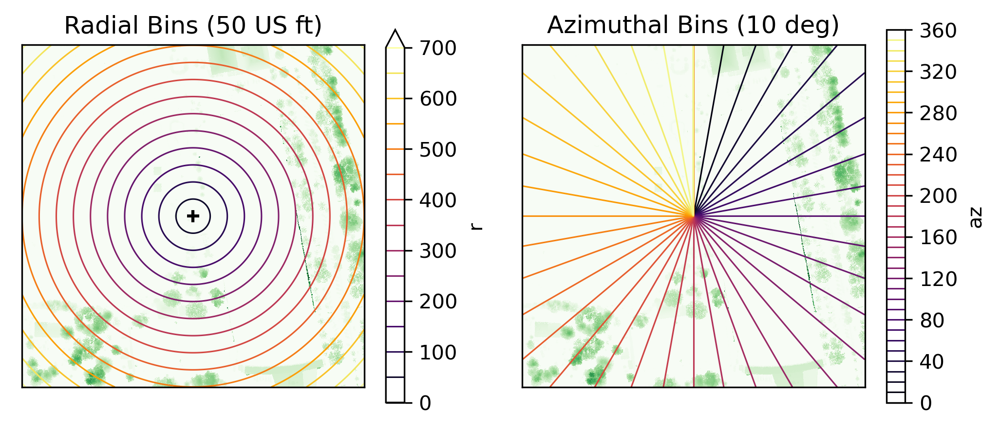

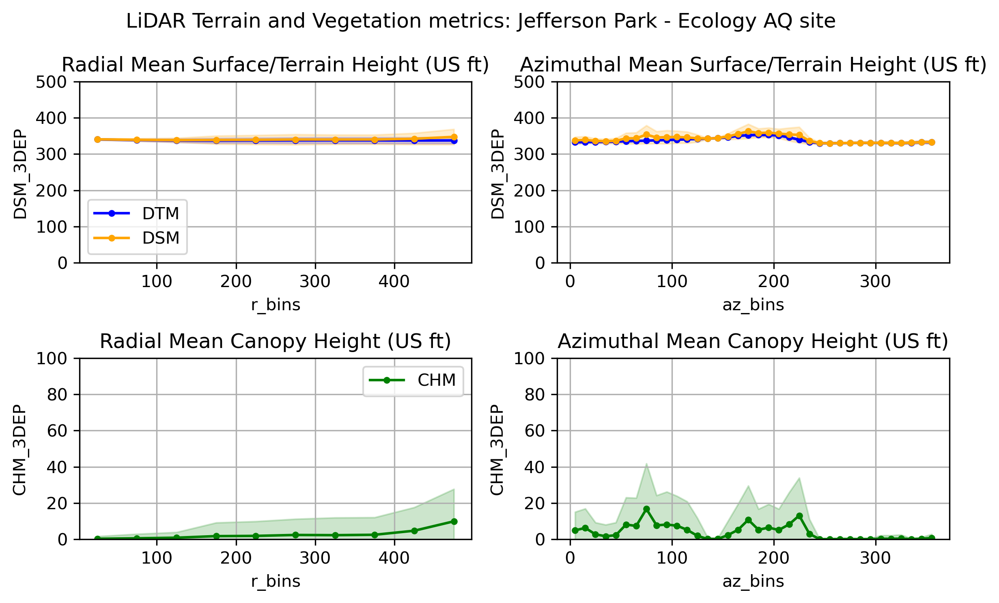

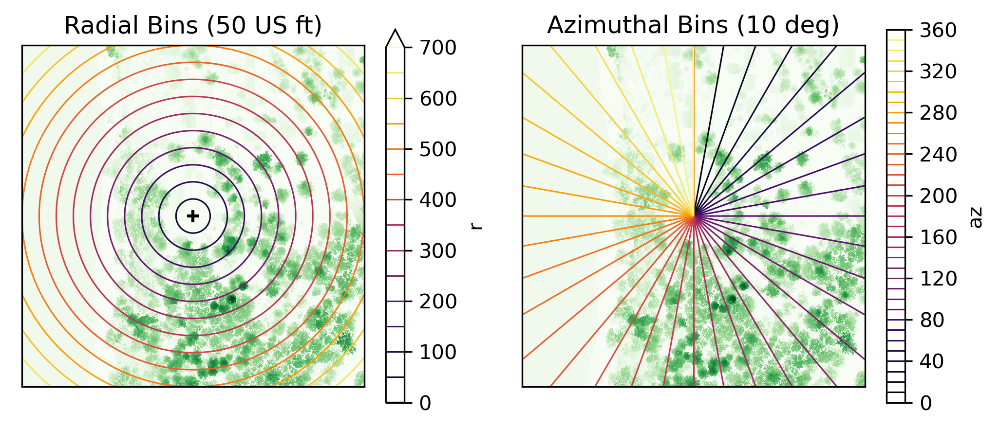

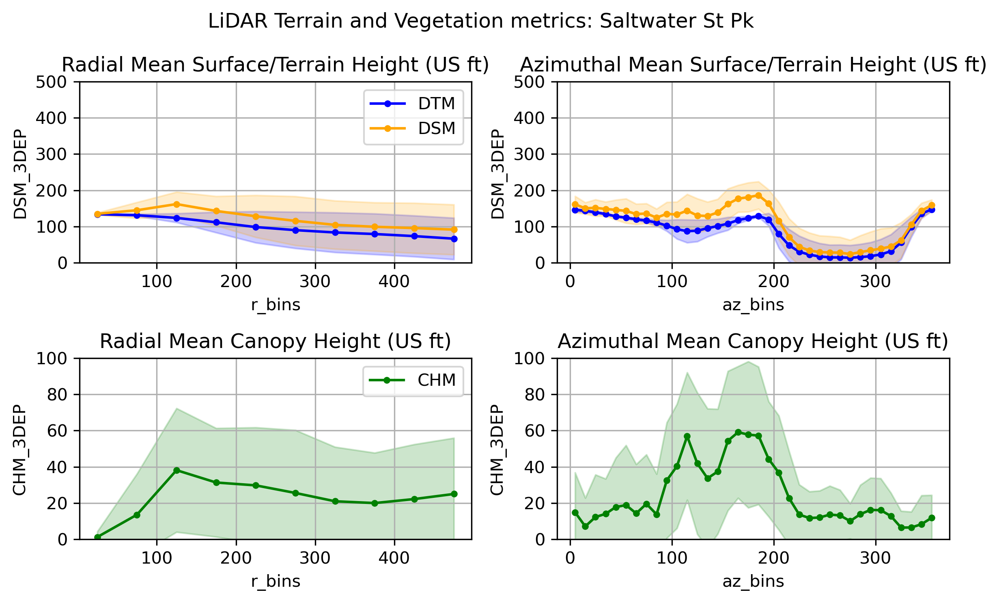

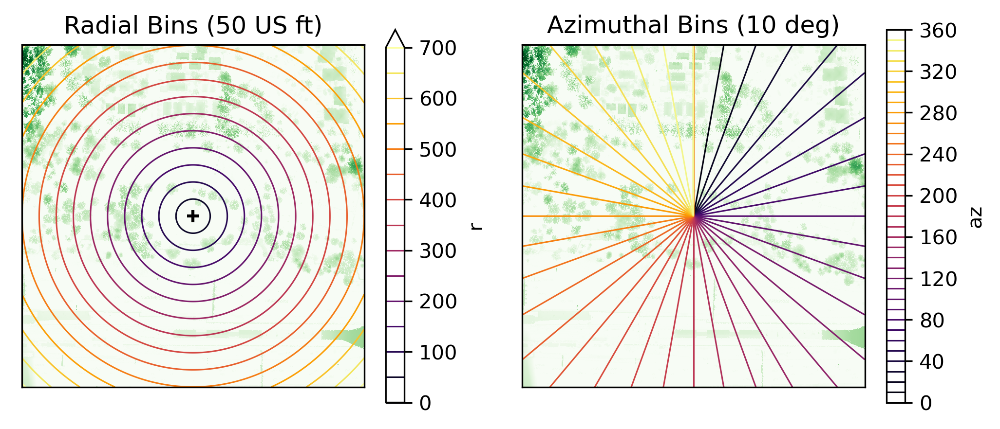

...

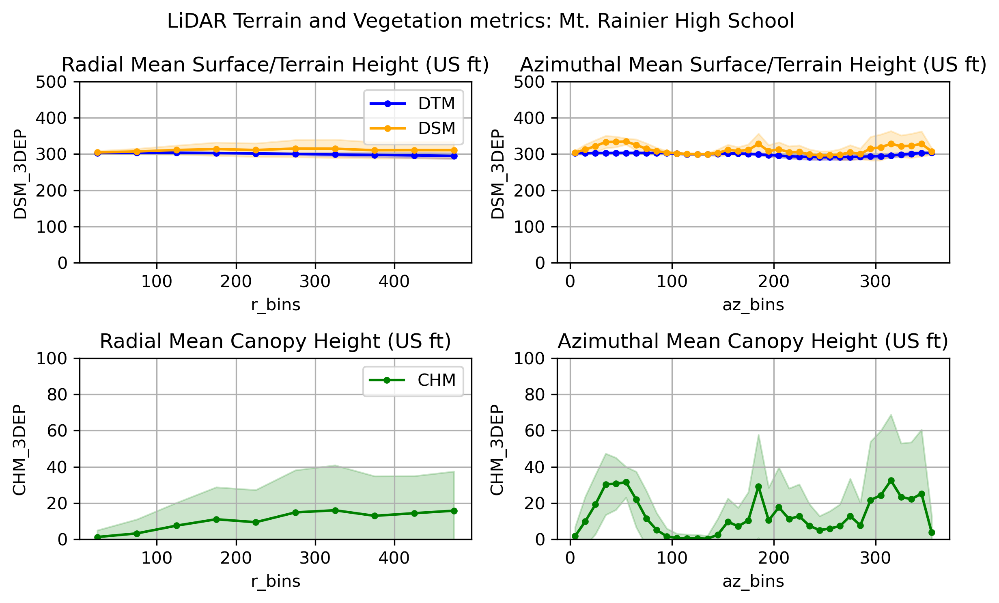

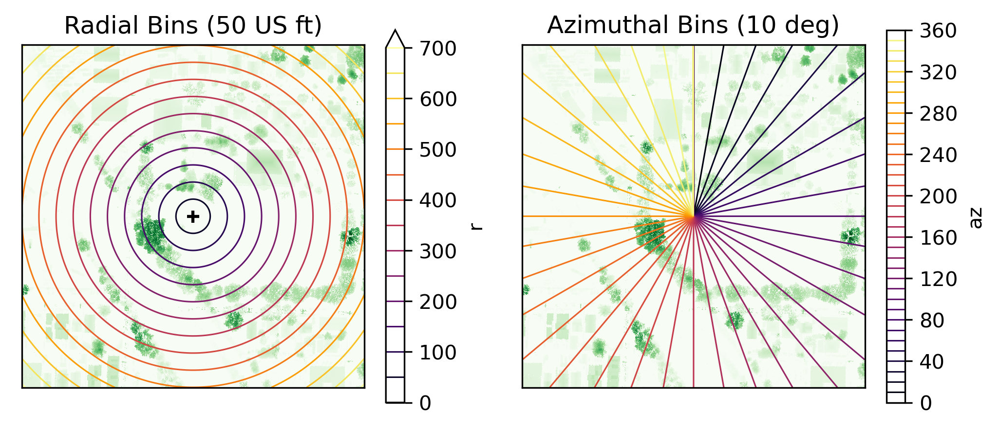

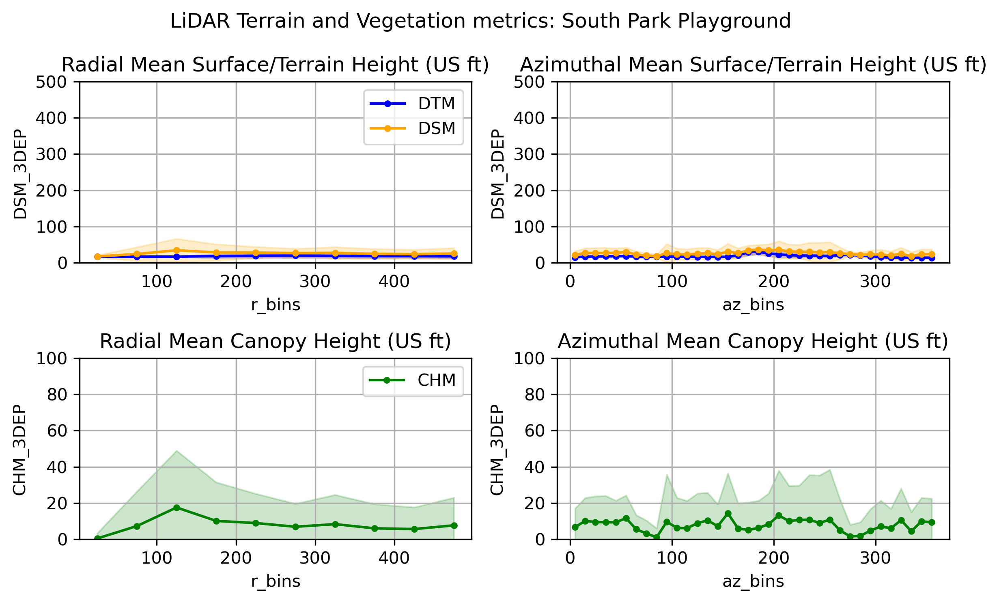

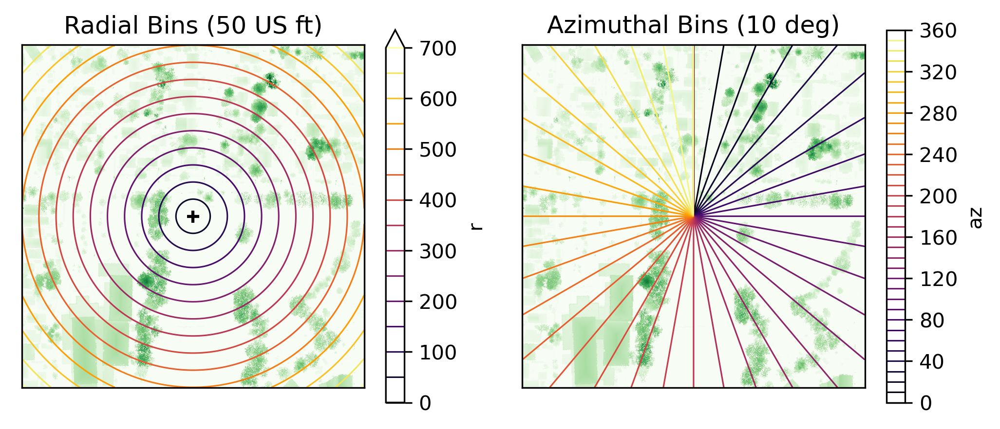

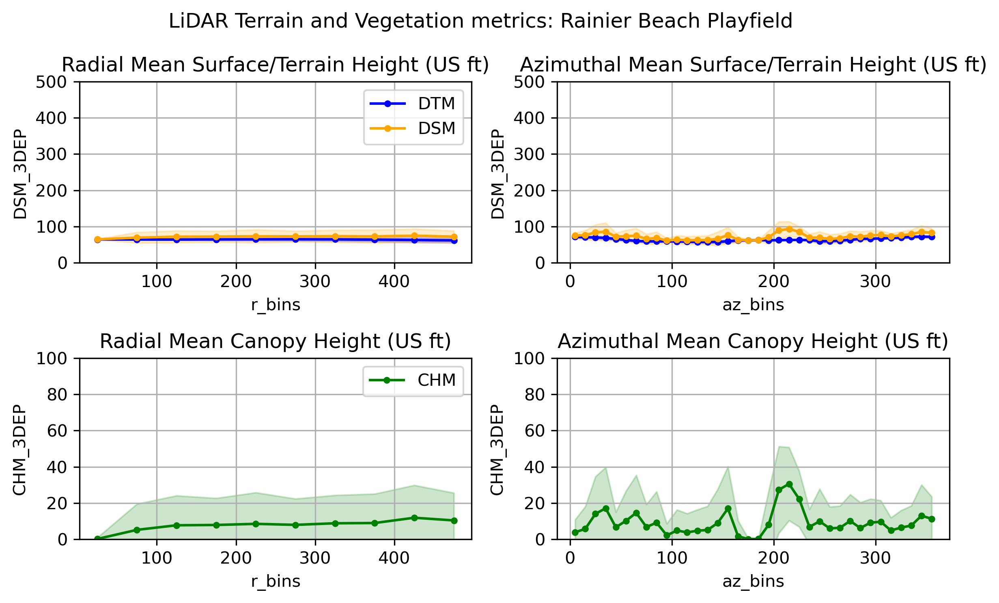

In [153]:
for site_name in site_list:
    print(site_name)
    xds = viz_site(site_name)

In [56]:
#For 6-band analysis
#(xds.DSM_PDAL - xds.DSM_3DEP).median(dim=['x','y'])
#(xds.DTM_PDAL - xds.DTM_3DEP).median(dim=['x','y'])

In [61]:
#Plot different versions of DSM, DTM and CHM
#(xds.DSM_PDAL - xds.DSM_3DEP).plot(cmap='RdBu', vmin=-10, vmax=10)
#(xds.DTM_PDAL - xds.DTM_3DEP).plot(cmap='RdBu', vmin=-10, vmax=10)
#(xds.CHM_PDAL - xds.CHM_3DEP).plot(cmap='RdBu', vmin=-10, vmax=10)
#xds.CHM_PDAL.plot()
#xds.CHM_3DEP.plot()

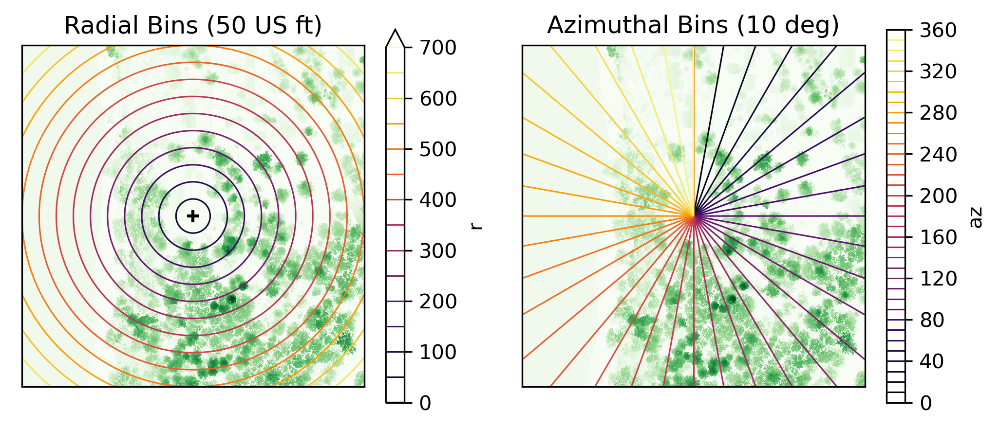

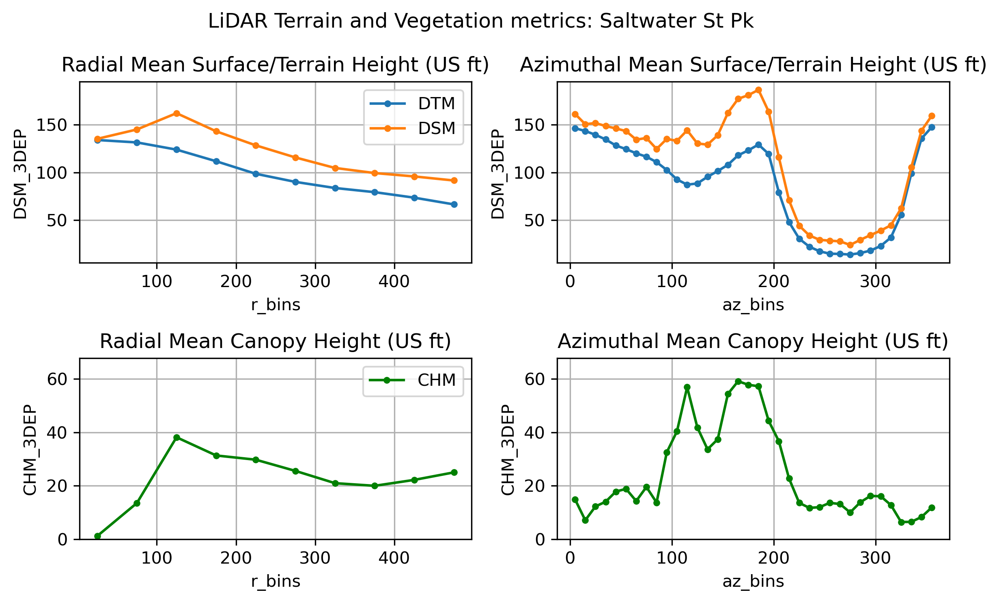

In [123]:
polarstats(xds)

In [137]:
    r_binwidth=50
    az_binwidth=10
    
    max_r = np.floor(np.max([(xds.x.max() - xds.x.min())/2., (xds.y.max() - xds.y.min())/2.]))
    xds_masked = xds.where((xds.r < max_r))

    # Radial bins
    r_bins = np.arange(0, xds_masked.coords['r'].max(), r_binwidth)
    r_bins_lbl = r_bins[:-1] + (r_binwidth/2)

    # Azimuth bins
    #az_bins = np.arange(0, xds_masked.coords['az'].max(), az_binwidth)
    az_bins = np.arange(0, 360+1, az_binwidth)
    az_bins_lbl = az_bins[:-1] + (az_binwidth/2)

    # group according to those bins and take the mean
    r_bin_mean = xds_masked.groupby_bins('r', r_bins, labels=r_bins_lbl).mean(dim=xr.ALL_DIMS)
    #r_bin_std = xds_masked.groupby_bins('r', r_bins, labels=r_bins_lbl).std(dim=xr.ALL_DIMS)
    r_bin_count = xds_masked.groupby_bins('r', r_bins, labels=r_bins_lbl).count(dim=xr.ALL_DIMS)
    #r_bin_norm = (r_bin_mean/r_bin_count)

    # group according to those bins and take the mean
    az_bin_mean = xds_masked.groupby_bins('az', az_bins, labels=az_bins_lbl).mean(dim=xr.ALL_DIMS)
    #az_bin_std = xds_masked.groupby_bins('az', az_bins, labels=az_bins_lbl).std(dim=xr.ALL_DIMS)
    az_bin_count = xds_masked.groupby_bins('az', az_bins, labels=az_bins_lbl).count(dim=xr.ALL_DIMS)
    #az_bin_norm = (az_bin_mean/az_bin_count)
    

In [117]:
out_col = ['DSM_3DEP', 'DTM_3DEP', 'CHM_3DEP', 'Intensity']

In [118]:
r_bin_mean.dropna(dim='r_bins').drop('spatial_ref')[out_col].to_dataframe()

,DSM_3DEP,DTM_3DEP,CHM_3DEP,Intensity
r_bins,,,,
25.0,135.197281,133.957169,1.240104,0.658716
75.0,145.002182,131.432587,13.569606,0.651598
125.0,162.050827,123.888573,38.162247,0.548006
175.0,143.081741,111.729095,31.352654,0.537485
225.0,128.370956,98.599205,29.771755,0.536063
275.0,115.700691,90.115318,25.585363,0.555097
325.0,104.708160,83.711853,20.996317,0.526639
375.0,99.376183,79.364624,20.011559,0.508438
425.0,95.820122,73.595413,22.224705,0.508621


In [119]:
xds_masked.coords['az'].max()

<xarray.DataArray 'az' ()>
array(359.91397037)
Coordinates:
    spatial_ref  int64 0

In [121]:
az_bin_mean.dropna(dim='az_bins').drop('spatial_ref')[out_col].to_dataframe()

,DSM_3DEP,DTM_3DEP,CHM_3DEP,Intensity
az_bins,,,,
5.0,161.236267,146.324356,14.911914,0.624743
15.0,150.495407,143.368774,7.126617,0.648498
25.0,151.719498,139.417206,12.302293,0.644442
35.0,148.595322,134.534622,14.060689,0.615168
45.0,146.084442,128.229645,17.854799,0.549433
55.0,143.299423,124.430000,18.869425,0.599253
65.0,134.343979,120.034805,14.309177,0.634411
75.0,136.079590,116.496635,19.582947,0.564509
85.0,124.574654,110.825333,13.749305,0.587342


In [78]:
xds_masked.mean()

<xarray.Dataset>
Dimensions:      ()
Coordinates:
    spatial_ref  int64 0
Data variables:
    DSM_PDAL     float32 105.7
    DTM_PDAL     float32 102.1
    DSM_3DEP     float32 110.2
    DTM_3DEP     float32 85.93
    DSM_PDAL_hs  float32 141.6
    DTM_PDAL_hs  float32 172.6
    DSM_3DEP_hs  float32 139.3
    DTM_3DEP_hs  float32 174.8
    Intensity    float32 0.5204
    CHM_PDAL     float32 21.34
    CHM_3DEP     float32 24.29

In [131]:
r_bin_std.CHM_3DEP.r_bins

<xarray.DataArray 'r_bins' (r_bins: 14)>
array([ 25.,  75., 125., 175., 225., 275., 325., 375., 425., 475., 525., 575.,
       625., 675.])
Coordinates:
  * r_bins       (r_bins) float64 25.0 75.0 125.0 175.0 ... 575.0 625.0 675.0
    spatial_ref  int64 0

In [128]:
r_bin_std.CHM_3DEP

<xarray.DataArray 'CHM_3DEP' (r_bins: 14)>
array([ 3.0495775, 22.561218 , 34.15305  , 29.969439 , 31.955042 ,
       34.69495  , 29.981321 , 27.733341 , 30.193207 , 30.911898 ,
              nan,        nan,        nan,        nan], dtype=float32)
Coordinates:
  * r_bins       (r_bins) float64 25.0 75.0 125.0 175.0 ... 575.0 625.0 675.0
    spatial_ref  int64 0

In [152]:
def polarstats(xds, r_binwidth=50, az_binwidth=10, plot=True):
    #Compute max radius and mask (remove data from corners)
    max_r = np.floor(np.max([(xds.x.max() - xds.x.min())/2., (xds.y.max() - xds.y.min())/2.]))
    xds_masked = xds.where((xds.r < max_r))

    # Radial bins
    r_bins = np.arange(0, xds_masked.coords['r'].max(), r_binwidth)
    r_bins_lbl = r_bins[:-1] + (r_binwidth/2)

    # Azimuth bins
    #az_bins = np.arange(0, xds_masked.coords['az'].max(), az_binwidth)
    az_bins = np.arange(0, 360+1, az_binwidth)
    az_bins_lbl = az_bins[:-1] + (az_binwidth/2)

    # group according to those bins and take the mean
    r_bin_mean = xds_masked.groupby_bins('r', r_bins, labels=r_bins_lbl).mean(dim=xr.ALL_DIMS)
    r_bin_std = xds_masked.groupby_bins('r', r_bins, labels=r_bins_lbl).std(dim=xr.ALL_DIMS)
    r_bin_count = xds_masked.groupby_bins('r', r_bins, labels=r_bins_lbl).count(dim=xr.ALL_DIMS)
    #r_bin_norm = (r_bin_mean/r_bin_count)

    # group according to those bins and take the mean
    az_bin_mean = xds_masked.groupby_bins('az', az_bins, labels=az_bins_lbl).mean(dim=xr.ALL_DIMS)
    az_bin_std = xds_masked.groupby_bins('az', az_bins, labels=az_bins_lbl).std(dim=xr.ALL_DIMS)
    az_bin_count = xds_masked.groupby_bins('az', az_bins, labels=az_bins_lbl).count(dim=xr.ALL_DIMS)
    #az_bin_norm = (az_bin_mean/az_bin_count)
    
    csv_fn = os.path.join(site_name, site_name+'_LiDAR_r_bins.csv')
    r_bin_mean.dropna(dim='r_bins').drop('spatial_ref')[out_col].to_dataframe().to_csv(csv_fn)
    csv_fn = os.path.join(site_name, site_name+'_LiDAR_az_bins.csv')
    az_bin_mean.dropna(dim='az_bins').drop('spatial_ref')[out_col].to_dataframe().to_csv(csv_fn)
    
    if plot:
        fig_fn = os.path.join(site_name, site_name+'_LiDAR_bins.png')
        f, axa = plt.subplots(1,2, figsize=(7,3), sharex=True, sharey=True, dpi=300)
        xds['CHM_3DEP'].drop('spatial_ref').plot(ax=axa[0], cmap='Greens', vmin=0, add_colorbar=False)
        xds['CHM_3DEP'].drop('spatial_ref').plot(ax=axa[1], cmap='Greens', vmin=0, add_colorbar=False)
        xds.coords['r'].drop('spatial_ref').plot.contour(ax=axa[0], x='x', y='y', cmap='inferno', linewidths=0.75, levels=r_bins, add_colorbar=True)
        xds.coords['az'].drop('spatial_ref').plot.contour(ax=axa[1], x='x', y='y', cmap='inferno', linewidths=0.75, levels=az_bins, add_colorbar=True)
        for ax in axa:
            ax.set_aspect('equal')
            ax.scatter(xds.attrs['xc'],xds.attrs['yc'], marker='+', color='k')
            hide_ticks(ax)
        axa[0].set_title(f'Radial Bins ({r_binwidth} {unit})')
        axa[1].set_title(f'Azimuthal Bins ({az_binwidth} deg)')
        plt.tight_layout()
        plt.savefig(fig_fn)
    
    if plot:
        #Set common colorbar/axes limits
        clim = [min(r_bin_mean.DTM_3DEP.min(), az_bin_mean.DTM_3DEP.min()), max(az_bin_mean.DSM_3DEP.max(), az_bin_mean.DSM_3DEP.max())]
        chm_clim = [0, max(r_bin_mean.CHM_3DEP.max(), az_bin_mean.CHM_3DEP.max())]
        pad = 0.05 * (clim[1] - clim[0])
        clim[0] -= pad
        clim[1] += pad
        chm_clim[1] += pad
        
        clim = [0,500]
        chm_clim = [0,100]

        fig_fn = os.path.join(site_name, site_name+'_LiDAR_stats.png')
        f, axa = plt.subplots(2,2, figsize=(8, 5), dpi=300)
        r_bin_mean.DTM_3DEP.drop('spatial_ref').plot(ax=axa[0,0], marker='.', label='DTM', color='blue')
        axa[0,0].fill_between(r_bin_std.DTM_3DEP.r_bins, r_bin_mean.DTM_3DEP-r_bin_std.DTM_3DEP, r_bin_mean.DTM_3DEP+r_bin_std.DTM_3DEP, color='blue', alpha=0.2)
        r_bin_mean.DSM_3DEP.drop('spatial_ref').plot(ax=axa[0,0], marker='.', label='DSM', color='orange')
        axa[0,0].fill_between(r_bin_std.DSM_3DEP.r_bins, r_bin_mean.DSM_3DEP-r_bin_std.DSM_3DEP, r_bin_mean.DSM_3DEP+r_bin_std.DSM_3DEP, color='orange', alpha=0.2)
        r_bin_mean.CHM_3DEP.drop('spatial_ref').plot(ax=axa[1,0], marker='.', color='green', label='CHM')
        axa[1,0].fill_between(r_bin_std.CHM_3DEP.r_bins, r_bin_mean.CHM_3DEP-r_bin_std.CHM_3DEP, r_bin_mean.CHM_3DEP+r_bin_std.CHM_3DEP, \
                              color='green', alpha=0.2)
        az_bin_mean.DTM_3DEP.drop('spatial_ref').plot(ax=axa[0,1], marker='.', color='blue')
        axa[0,1].fill_between(az_bin_std.DTM_3DEP.az_bins, az_bin_mean.DTM_3DEP-az_bin_std.DTM_3DEP, az_bin_mean.DTM_3DEP+az_bin_std.DTM_3DEP, color='blue', alpha=0.2)
        az_bin_mean.DSM_3DEP.drop('spatial_ref').plot(ax=axa[0,1], marker='.', color='orange')
        axa[0,1].fill_between(az_bin_std.DSM_3DEP.az_bins, az_bin_mean.DSM_3DEP-az_bin_std.DSM_3DEP, az_bin_mean.DSM_3DEP+az_bin_std.DSM_3DEP, color='orange', alpha=0.2)
        az_bin_mean.CHM_3DEP.drop('spatial_ref').plot(ax=axa[1,1], marker='.', color='green')
        axa[1,1].fill_between(az_bin_std.CHM_3DEP.az_bins, az_bin_mean.CHM_3DEP-az_bin_std.CHM_3DEP, az_bin_mean.CHM_3DEP+az_bin_std.CHM_3DEP, \
                      color='green', alpha=0.2)
        axa[0,0].set_ylim(*clim)
        axa[0,1].set_ylim(*clim)
        axa[1,0].set_ylim(*chm_clim)
        axa[1,1].set_ylim(*chm_clim)
        axa[0,0].legend()
        axa[0,0].set_title(f'Radial Mean Surface/Terrain Height ({unit})')
        axa[0,1].set_title(f'Azimuthal Mean Surface/Terrain Height ({unit})')
        axa[1,0].set_title(f'Radial Mean Canopy Height ({unit})')
        axa[1,1].set_title(f'Azimuthal Mean Canopy Height ({unit})')
        axa[1,0].legend()
        for ax in axa.ravel():
            ax.grid()
        plt.suptitle(f'LiDAR Terrain and Vegetation metrics: {site_name}')
        plt.tight_layout()
        plt.savefig(fig_fn)

/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/dshean/sw/miniconda3/envs/shean_py3_amd/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarnin

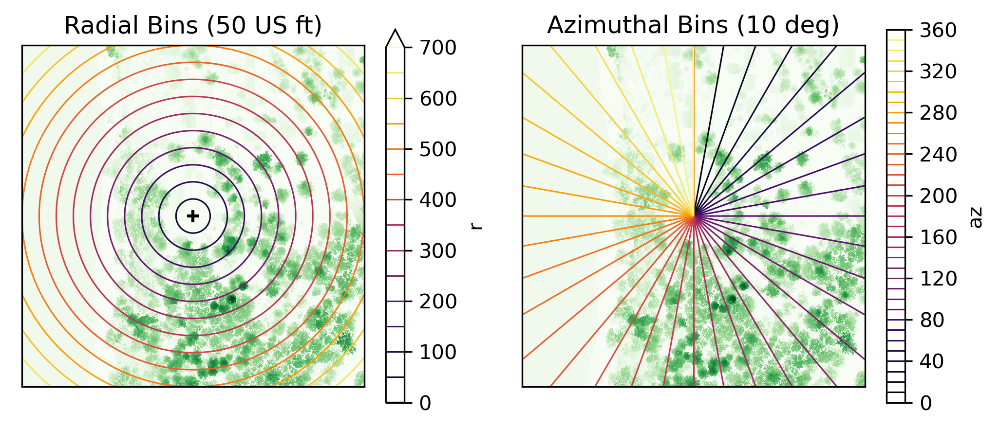

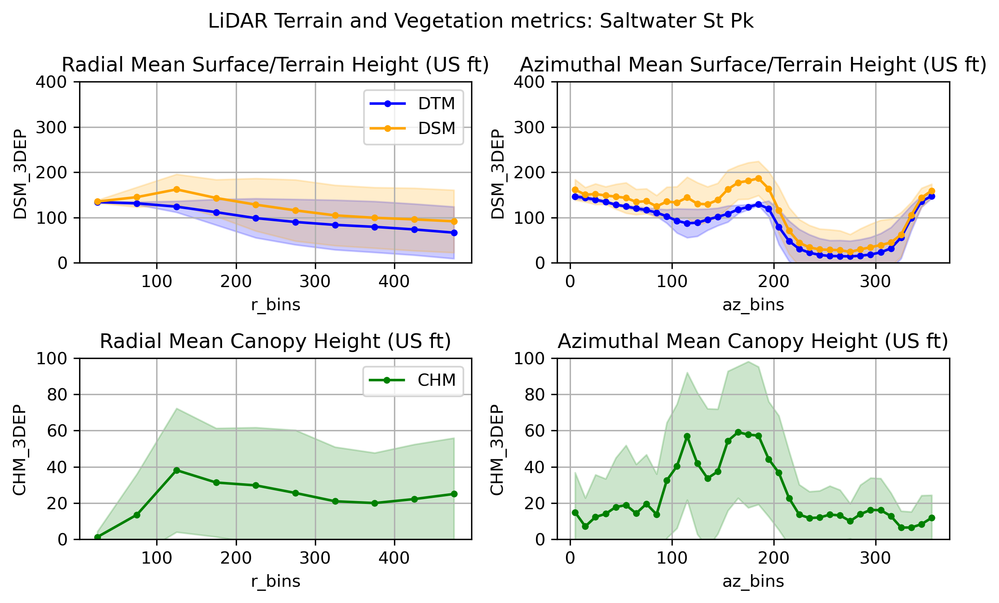

In [147]:
polarstats(xds)

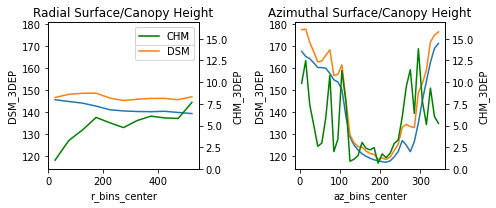

In [84]:
f, axa = plt.subplots(1,2, figsize=(7,3))
ax2 = axa[0].twinx()
ax3 = axa[1].twinx()
r_bin_mean.DTM_3DEP.drop('spatial_ref').plot(ax=axa[0], label='DTM')
r_bin_mean.DSM_3DEP.drop('spatial_ref').plot(ax=axa[0], label='DSM')
r_bin_mean.CHM_3DEP.drop('spatial_ref').plot(ax=ax2, color='green', label='CHM')
az_bin_mean.DTM_3DEP.drop('spatial_ref').plot(ax=axa[1])
az_bin_mean.DSM_3DEP.drop('spatial_ref').plot(ax=axa[1])
az_bin_mean.CHM_3DEP.drop('spatial_ref').plot(ax=ax3, color='green')
axa[0].set_ylim(*clim)
axa[1].set_ylim(*clim)
ax2.set_ylim(*chm_clim)
ax3.set_ylim(*chm_clim)
axa[0].legend()
axa[0].set_title('Radial Surface/Canopy Height')
axa[1].set_title('Azimuthal Surface/Canopy Height')
ax2.legend()
plt.tight_layout()

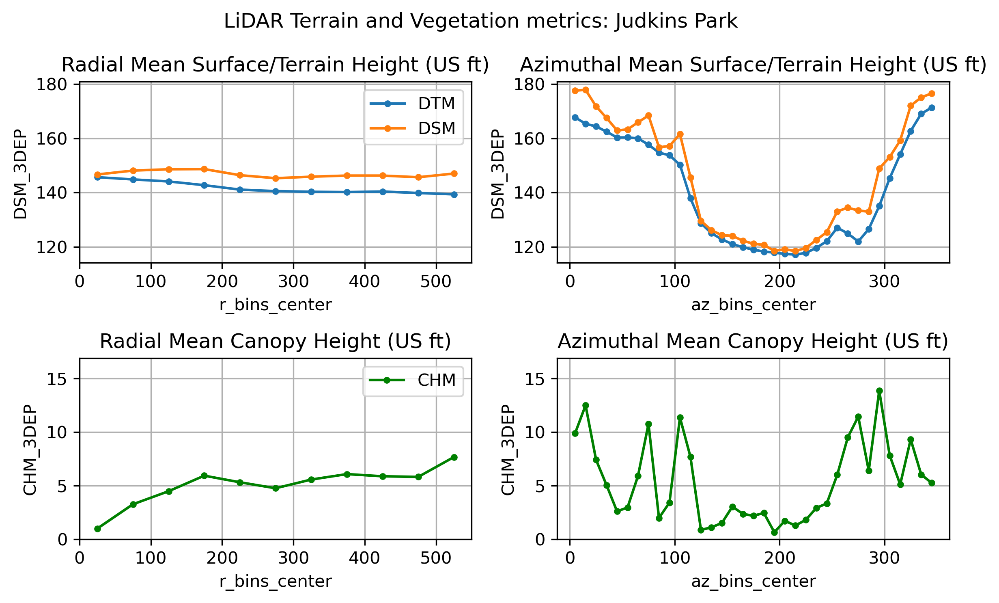

In [85]:
fig_fn = os.path.join(site_name, site_name+'_LiDAR_r_az_mean.png')
f, axa = plt.subplots(2,2, figsize=(8, 5), dpi=300)
r_bin_mean.DTM_3DEP.drop('spatial_ref').plot(ax=axa[0,0], marker='.', label='DTM')
r_bin_mean.DSM_3DEP.drop('spatial_ref').plot(ax=axa[0,0], marker='.', label='DSM')
r_bin_mean.CHM_3DEP.drop('spatial_ref').plot(ax=axa[1,0], marker='.', color='green', label='CHM')
az_bin_mean.DTM_3DEP.drop('spatial_ref').plot(ax=axa[0,1], marker='.')
az_bin_mean.DSM_3DEP.drop('spatial_ref').plot(ax=axa[0,1], marker='.')
az_bin_mean.CHM_3DEP.drop('spatial_ref').plot(ax=axa[1,1], marker='.', color='green')
axa[0,0].set_ylim(*clim)
axa[0,1].set_ylim(*clim)
axa[1,0].set_ylim(*chm_clim)
axa[1,1].set_ylim(*chm_clim)
axa[0,0].legend()
axa[0,0].set_title(f'Radial Mean Surface/Terrain Height ({unit})')
axa[0,1].set_title(f'Azimuthal Mean Surface/Terrain Height ({unit})')
axa[1,0].set_title(f'Radial Mean Canopy Height ({unit})')
axa[1,1].set_title(f'Azimuthal Mean Canopy Height ({unit})')
axa[1,0].legend()
for ax in axa.ravel():
    ax.grid()
plt.suptitle(f'LiDAR Terrain and Vegetation metrics: {site_name}')
plt.tight_layout()
plt.savefig(fig_fn)